<a href="https://colab.research.google.com/github/ditaangelia70/AssignmentHactiv8/blob/main/Copy_of_YOLO1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Instalasi library yang diperlukan
!pip install torch torchvision torchaudio pytorch-lightning --quiet
!pip install ultralytics --quiet  # Untuk YOLOv5/YOLOv8
!pip install opencv-python-headless --quiet

print("Semua library berhasil diinstal!")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 24.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 38.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.8/898.8 kB 32.8 MB/s eta 0:00:00
Semua library berhasil diinstal!


In [2]:
# Import library yang diperlukan
import torch
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from ultralytics import YOLO
from PIL import Image
import cv2
import numpy as np
from tqdm import tqdm
from torchvision.datasets import CocoDetection
from torchvision.transforms import ToTensor

print("Semua library berhasil di-import!")


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Semua library berhasil di-import!


In [3]:
!pip install fiftyone

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
INFO: pip is looking at multiple versions of motor to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.5/10.5 MB 107.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.9/108.9 kB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.7/99.7 kB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.7/74.7 kB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 64.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 73.2/73.2 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 943.1/943.1 kB 50.6 MB/s eta 0:00:00
   ━━━━━━━━━━━

In [4]:
import fiftyone as fo
import fiftyone.zoo as foz

# Load the COCO dataset, but only the validation split and only the "person" classes
dataset = foz.load_zoo_dataset(
    "coco-2017",
    splits=["validation"],  # Only load the validation split
    classes=["person"],  # Only load these classes
)

# Launch FiftyOne App
session = fo.launch_app(dataset)

INFO:fiftyone.zoo.datasets:Downloading split 'validation' to '/root/fiftyone/coco-2017/validation' if necessary


INFO:fiftyone.utils.coco:Downloading annotations to '/root/fiftyone/coco-2017/tmp-download/annotations_trainval2017.zip'


 100% |██████|    1.9Gb/1.9Gb [7.0s elapsed, 0s remaining, 282.0Mb/s]       


INFO:eta.core.utils: 100% |██████|    1.9Gb/1.9Gb [7.0s elapsed, 0s remaining, 282.0Mb/s]       


Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Extracting annotations to '/root/fiftyone/coco-2017/raw/instances_val2017.json'


INFO:fiftyone.utils.coco:Downloading 2693 images


 100% |████████████████| 2693/2693 [12.2m elapsed, 0s remaining, 3.8 images/s]      


INFO:eta.core.utils: 100% |████████████████| 2693/2693 [12.2m elapsed, 0s remaining, 3.8 images/s]      


Writing annotations for 2693 downloaded samples to '/root/fiftyone/coco-2017/validation/labels.json'


INFO:fiftyone.utils.coco:Writing annotations for 2693 downloaded samples to '/root/fiftyone/coco-2017/validation/labels.json'


Dataset info written to '/root/fiftyone/coco-2017/info.json'


INFO:fiftyone.zoo.datasets:Dataset info written to '/root/fiftyone/coco-2017/info.json'


Loading 'coco-2017' split 'validation'


INFO:fiftyone.zoo.datasets:Loading 'coco-2017' split 'validation'


 100% |███████████████| 2693/2693 [20.9s elapsed, 0s remaining, 105.3 samples/s]      


INFO:eta.core.utils: 100% |███████████████| 2693/2693 [20.9s elapsed, 0s remaining, 105.3 samples/s]      


Dataset 'coco-2017-validation' created


INFO:fiftyone.zoo.datasets:Dataset 'coco-2017-validation' created



Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.1.0

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



INFO:fiftyone.core.session.session:
Welcome to

███████╗██╗███████╗████████╗██╗   ██╗ ██████╗ ███╗   ██╗███████╗
██╔════╝██║██╔════╝╚══██╔══╝╚██╗ ██╔╝██╔═══██╗████╗  ██║██╔════╝
█████╗  ██║█████╗     ██║    ╚████╔╝ ██║   ██║██╔██╗ ██║█████╗
██╔══╝  ██║██╔══╝     ██║     ╚██╔╝  ██║   ██║██║╚██╗██║██╔══╝
██║     ██║██║        ██║      ██║   ╚██████╔╝██║ ╚████║███████╗
╚═╝     ╚═╝╚═╝        ╚═╝      ╚═╝    ╚═════╝ ╚═╝  ╚═══╝╚══════╝ v1.1.0

If you're finding FiftyOne helpful, here's how you can get involved:

|
|  ⭐⭐⭐ Give the project a star on GitHub ⭐⭐⭐
|  https://github.com/voxel51/fiftyone
|
|  🚀🚀🚀 Join the FiftyOne Discord community 🚀🚀🚀
|  https://community.voxel51.com/
|



In [5]:
# Filter untuk hanya menyertakan anotasi dengan label "person"
person_view = dataset.filter_labels("ground_truth", fo.ViewField("label") == "person")

# Verifikasi jumlah sampel dengan bounding box "person"
print(f"Number of samples with 'person': {len(person_view)}")


Number of samples with 'person': 2693


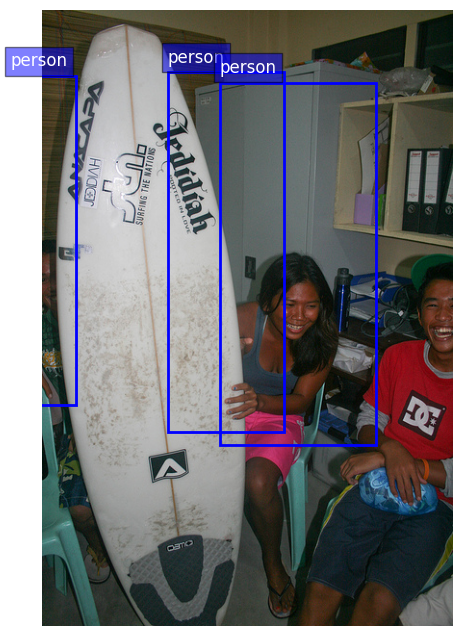

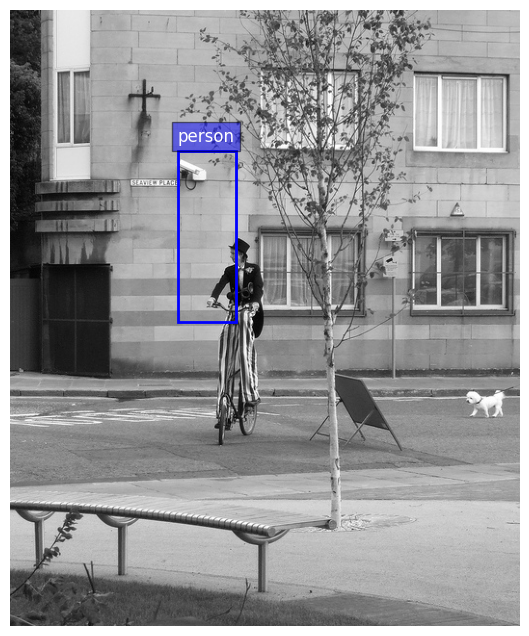

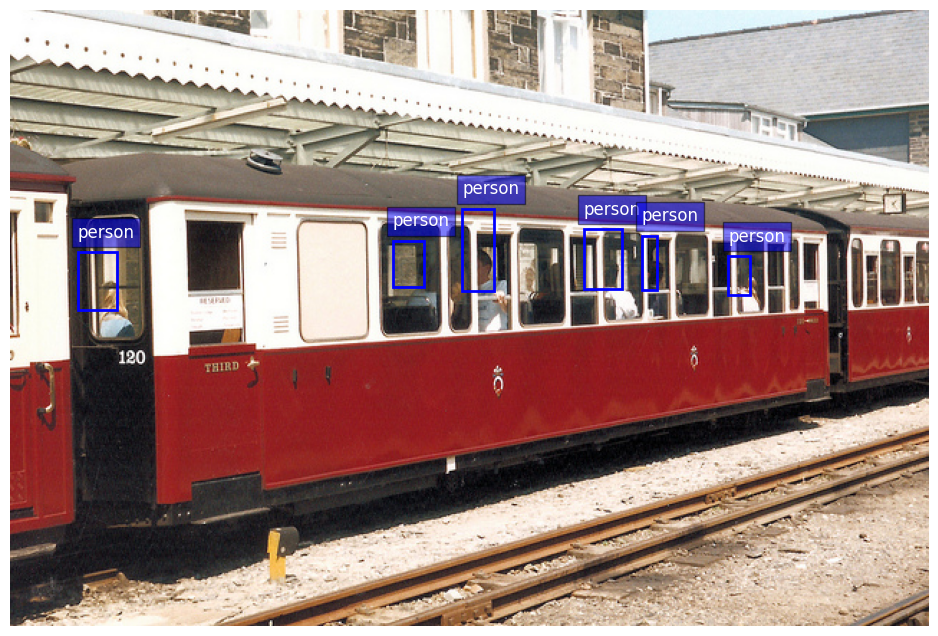

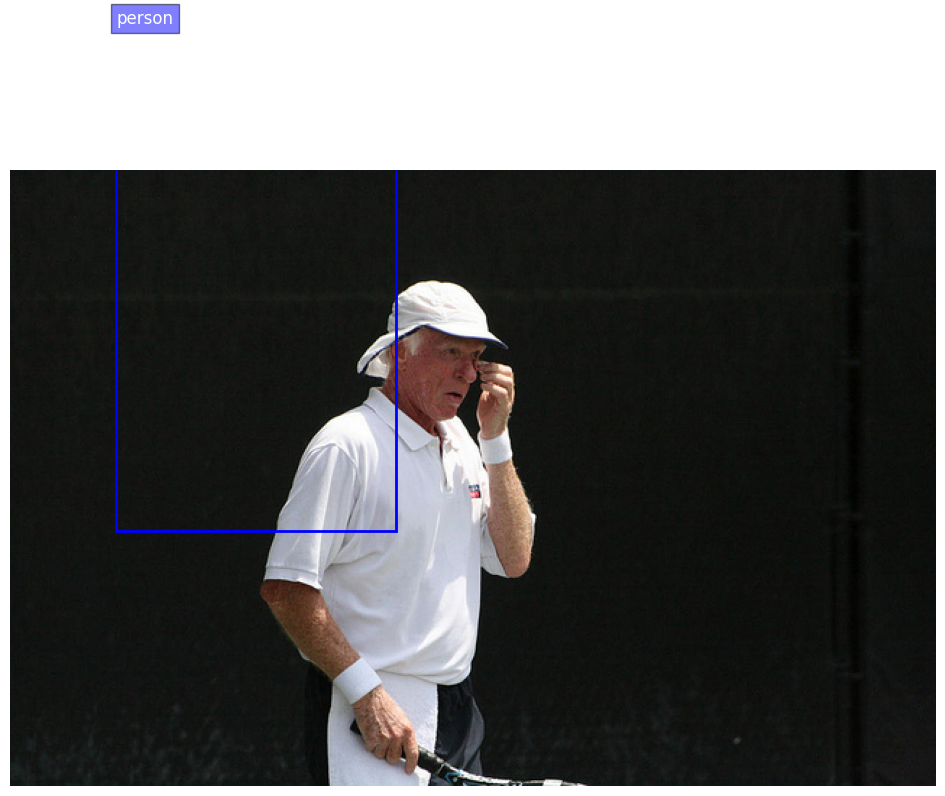

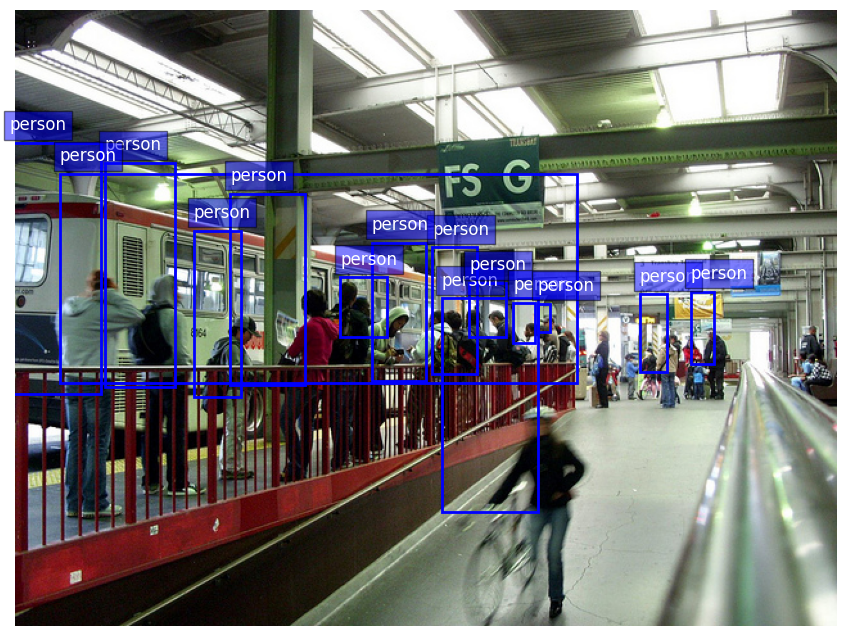

In [6]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image

# Tampilkan beberapa gambar dengan bounding box "person"
for sample in person_view.take(5):  # Ambil 5 sampel pertama
    img_path = sample.filepath
    img = Image.open(img_path)
    detections = sample.ground_truth.detections

    # Buat plot
    fig, ax = plt.subplots(1, figsize=(12, 8))
    ax.imshow(img)

    for detection in detections:
        label = detection.label
        bbox = detection.bounding_box  # [x, y, width, height] (YOLO format)

        # Konversi ke koordinat gambar
        x_center, y_center, width, height = bbox
        x = (x_center - width / 2) * img.width
        y = (y_center - height / 2) * img.height
        w = width * img.width
        h = height * img.height

        # Gambar bounding box
        rect = patches.Rectangle(
            (x, y), w, h, linewidth=2, edgecolor="blue", facecolor="none"
        )
        ax.add_patch(rect)
        ax.text(x, y - 10, label, color="white", fontsize=12, bbox=dict(facecolor="blue", alpha=0.5))

    plt.axis("off")
    plt.show()


In [7]:
import os
import random
import shutil
import yaml

In [8]:
# prompt: buatkan code untuk split datanya jadi train sama test 80:20

import os
import random
import shutil

# Define the source directory containing the images and the ratio for splitting
source_dir = "/content/cloned-repo/coco-2017/validation"  # Ganti dengan path yang sesuai
train_ratio = 0.8

# Create the train and test directories if they don't exist
train_dir = os.path.join(source_dir, "train")
test_dir = os.path.join(source_dir, "test")

os.makedirs(train_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Get the list of image files in the source directory
image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]


# Shuffle the image files randomly
random.shuffle(image_files)

# Calculate the split index
split_index = int(len(image_files) * train_ratio)

# Split the image files into train and test sets
train_files = image_files[:split_index]
test_files = image_files[split_index:]

# Move the image files to their respective directories
for filename in train_files:
    source_path = os.path.join(source_dir, filename)
    destination_path = os.path.join(train_dir, filename)
    shutil.move(source_path, destination_path)

for filename in test_files:
    source_path = os.path.join(source_dir, filename)
    destination_path = os.path.join(test_dir, filename)
    shutil.move(source_path, destination_path)

print(f"Data splitting complete. Train set size: {len(train_files)}, Test set size: {len(test_files)}")

Data splitting complete. Train set size: 0, Test set size: 0


In [9]:
# Direktori ekspor
export_dir = "./yolo_person_dataset"

# Ekspor dataset ke format YOLO
person_view.export(
    export_dir=export_dir,
    dataset_type=fo.types.YOLOv5Dataset,
    label_field="ground_truth",
)
print(f"Dataset exported to {export_dir}")


 100% |███████████████| 2693/2693 [10.0s elapsed, 0s remaining, 251.5 samples/s]     


INFO:eta.core.utils: 100% |███████████████| 2693/2693 [10.0s elapsed, 0s remaining, 251.5 samples/s]     


Dataset exported to ./yolo_person_dataset
